# Taller-1

MINE-4101: Applied Data Science  
Univerisdad de los Andes  
  

In [17]:
!pip install --upgrade pandas-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
!pip install markupsafe==2.0.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [19]:
# Importing libraries

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from pandas_profiling import ProfileReport

%matplotlib inline

### Loading the data

In [13]:
# Loading the CSV file as dataframe
spotify_df = pd.read_csv('/content/Data_Taller_1.csv')#.dropna()

In [14]:
# Showing dataframe dimensions
spotify_df.shape

(2000, 19)

In [15]:
# Showing column types
spotify_df.dtypes

artist               object
song                 object
duration_ms          object
explicit             object
year                 object
popularity          float64
danceability        float64
energy              float64
key                 float64
loudness            float64
mode                float64
speechiness         float64
acousticness        float64
instrumentalness    float64
liveness            float64
valence             float64
tempo               float64
genre                object
Unnamed: 18          object
dtype: object

In [16]:
# Showing first rows
spotify_df.head()

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre,Unnamed: 18
0,Britney Spears,Oops!...I Did It Again,211160,False,2000,77.0,0.751,0.834,1.0,-5.444,0.0,0.0437,0.3000,0.000018,0.3550,0.894,95.053,pop,NaN
1,"blink-182,All The Small Things,167066,False,19...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"Faith Hill,Breathe,250546,False,1999,66,0.529,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"Bon Jovi,It's My Life,224493,False,2000,78,0.5...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,*NSYNC,Bye Bye Bye,200560,False,2000,NaN,0.614,0.928,8.0,-4.806,0.0,0.0516,0.0408,0.001040,0.0845,0.879,172.656,pop,NaN


In [22]:
x = spotify_df.explode('artist')
x.head()

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre,Unnamed: 18
0,Britney Spears,Oops!...I Did It Again,211160,False,2000,77.0,0.751,0.834,1.0,-5.444,0.0,0.0437,0.3000,0.000018,0.3550,0.894,95.053,pop,NaN
1,"blink-182,All The Small Things,167066,False,19...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"Faith Hill,Breathe,250546,False,1999,66,0.529,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"Bon Jovi,It's My Life,224493,False,2000,78,0.5...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,*NSYNC,Bye Bye Bye,200560,False,2000,NaN,0.614,0.928,8.0,-4.806,0.0,0.0516,0.0408,0.001040,0.0845,0.879,172.656,pop,NaN


# Punto 1 (5 pts) Describa el conjunto de datos, tipos de variables y destaque cualquier problema de calidad de datos y procesos de limpieza que deba implementar.

### RESPUESTA:

* artist               variable categórica nominal
* song                 variabe categórica nominal
* duration_ms          numérica continua
* explicit             categorica nominal
* year                 numérica discreta
* popularity           numérica discreta
* danceability         numérica continua
* energy              numérica continua
* key                 numérica discreta
* loudness            numérica continua
* mode                categórica nominal
* speechiness         numérica continua
* acousticness        numérica continua
* instrumentalness    numérica continua
* liveness            numérica continua
* valence             numérica continua 
* tempo               numérica continua
* genre                categórica nominal

El archivo presenta varias inconsistencias lo cual no permite que el archivo csv sea iterado de manera correcta, lo cual hace que tengamos todos los datos de varias canciones de diferentes artistas en una columna sin posibilidad de extender esos datos en el dataframe. También hay una columna extra sin nombre que no contiene datos de interés, O datos como set() en la columna de género.  Ya que la forma de los datos no estaban organizados de forma correcta las herramientas de pandas limitaban su limpieza, por eso, fue más sencillo abrir el archivo en excel y separar el string en columnas, guardarlo y leerlo a partir de un archivo xlsx.




In [296]:
# Loading the CSV file as dataframe
spotify_df = pd.read_excel('/content/Data_Taller_1.xlsx')#.dropna()
#spotify_df = spotify_df.drop('Unnamed: 18', axis=1)
spotify_df.head(100)

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre
0,Britney Spears,Oops!...I Did It Again,211160.0,False,2000,77.0,0.751,0.834,1,-5444.0,0,0.0437,0.300000,0.000018,0.3550,0.894,95053.0,pop
1,blink-182,All The Small Things,167066.0,False,1999,79.0,0.434,0.897,0,-4918.0,1,0.0488,0.010300,0.000000,0.6120,0.684,148726.0,"""rock, pop"""
2,Faith Hill,Breathe,250546.0,False,1999,66.0,0.529,0.496,7,-9007.0,1,0.0290,0.173000,0.000000,0.2510,0.278,136859.0,"pop, country"
3,Bon Jovi,It's My Life,224493.0,False,2000,78.0,0.551,0.913,0,-4063.0,0,0.0466,0.026300,0.000013,0.3470,0.544,119992.0,"rock, metal"
4,*NSYNC,Bye Bye Bye,200560.0,False,2000,NaN,0.614,0.928,8,-4806.0,0,0.0516,0.040800,0.001040,0.0845,0.879,172656.0,pop
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Wheatus,Teenage Dirtbag,241666.0,True,1999,71.0,0.625,0.850,4,-3904.0,1,0.0495,0.346000,0.000233,0.1740,0.633,94661.0,set()
96,Christina Aguilera,Come on over Baby (All I Want Is You) - Radio ...,203333.0,False,1999,64.0,0.829,0.915,8,-3205.0,1,0.1060,0.226000,0.000013,0.2460,0.779,118903.0,pop
97,Creed,Higher,316733.0,False,1999,69.0,0.459,0.830,2,-6254.0,1,0.0364,0.000051,0.000140,0.2060,0.431,155827.0,"pop, rock, metal"
98,Britney Spears,Lucky,206226.0,False,2000,65.0,0.765,0.791,8,-5707.0,1,0.0317,0.262000,0.000154,0.0669,0.966,95026.0,pop


In [257]:
ProfileReport(spotify_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Punto 1 (5 pts) ¿Cuál es el top 10 de artistas más activos de los últimos 10 años?

In [329]:
pnt_1_df['year'] = spotify_df['year'].astype(str).astype(int)
pnt_1_df = spotify_df[spotify_df['year']<=1997]
pnt_1_df = pnt_1_df.groupby(by = 'artist')['artist'].count().sort_values(ascending = False)
pnt_1_df.head(15)

Series([], Name: artist, dtype: int64)

In [297]:

pnt_1_df['year'] = spotify_df['year'].astype(str).astype(int)
pnt_1_df = spotify_df[spotify_df['year']>=2012]
pnt_1_df = pnt_1_df.groupby(by = 'artist')['artist'].count().sort_values(ascending = False)
pnt_1_df.head(15)

artist
Calvin Harris       18
Drake               16
Ariana Grande       14
Taylor Swift        13
David Guetta        13
Katy Perry          11
Selena Gomez         9
Maroon 5             9
One Direction        9
Post Malone          9
Ed Sheeran           9
Avicii               9
The Chainsmokers     8
Justin Bieber        8
The Weeknd           8
Name: artist, dtype: int64

###  RESPUESTA: los artistas más activos en los ultimos 10 años basado en la cantidad de canciones en lso ultimos 10 años:

*  Calvin Harris       18
* Drake               16
* Ariana Grande       14
* Taylor Swift        13
* David Guetta        13
* Katy Perry          11
* Selena Gomez         9
* Maroon 5             9
* One Direction        9
* Post Malone          9


# Punto 2 (10 pts) ¿Cómo se diferencian las canciones de los géneros de Latin y Folk/Acoustic en relación con su duración? Halle la diferencia del tiempo promedio de ambos géneros.

In [59]:


mask = spotify_df['genre'].str.contains('Folk/Acoustic', case=False, na=False)
pnt2_df = spotify_df[mask]
pnt2_mean_folk = pnt2_df['duration_ms'].mean()
pnt2_mean_folk

220183.65

In [60]:

mask = spotify_df['genre'].str.contains('latin', case=False, na=False)
pnt2_df = spotify_df[mask]
pnt2_mean_latin = pnt2_df['duration_ms'].mean()
pnt2_mean_latin

227674.859375

In [62]:
rpta = abs(pnt2_mean_latin-pnt2_mean_folk)
rpta

7491.209375000006

### RESPUESTA: la diferencia de tiempo es de ~ 7.491 segundos en promedio

# Punto 3 (15 pts) Halle el top 5 de los géneros del 2019 según la cantidad de canciones. ¿Cómo ha variado la cantidad de canciones del Top de géneros en los años 2000, 2005, 2010, 2015, 2019?

In [110]:
#pnt3_df['year'] = spotify_df['year'].astype(str).astype(int)
# 2019
pnt3_df = spotify_df[spotify_df['year']==2019]
pnt3_df['genre'] = spotify_df['genre'].str.replace(',','-')
pnt3_df.groupby(by = 'genre')['song'].count().sort_values(ascending = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


genre
pop                                 25
hip hop                             13
pop- Dance/Electronic               13
hip hop- pop                        10
hip hop- pop- R&B                    7
latin                                6
hip hop- Dance/Electronic            3
hip hop- pop- Dance/Electronic       3
pop- R&B                             2
pop- rock- metal                     2
Dance/Electronic                     1
hip hop- country                     1
hip hop- latin- Dance/Electronic     1
pop- latin                           1
set()                                1
Name: song, dtype: int64

In [111]:
# 2000
pnt3_df = spotify_df[spotify_df['year']==2000]
pnt3_df['genre'] = spotify_df['genre'].str.replace(',','-')
pnt3_df.groupby(by = 'genre')['song'].count().sort_values(ascending = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


genre
pop                                 16
pop- R&B                            11
hip hop- pop- R&B                   10
pop- rock                            4
hip hop                              4
hip hop- pop                         4
pop- Dance/Electronic                4
R&B                                  3
rock- metal                          3
hip hop- pop- latin                  2
metal                                2
pop- rock- metal                     2
rock- pop                            1
rock                                 1
Dance/Electronic                     1
pop- latin                           1
pop- Folk/Acoustic                   1
Folk/Acoustic- rock                  1
hip hop- R&B                         1
World/Traditional- Folk/Acoustic     1
rock- pop- metal                     1
Name: song, dtype: int64

In [109]:
# 2005
pnt3_df = spotify_df[spotify_df['year']==2005]
pnt3_df['genre'] = spotify_df['genre'].str.replace(',','-')
pnt3_df.groupby(by = 'genre')['song'].count().sort_values(ascending = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


genre
hip hop- pop                             21
hip hop- pop- R&B                        18
pop- R&B                                 12
pop                                      10
hip hop                                   8
rock                                      6
rock- metal                               5
rock- pop                                 4
pop- Dance/Electronic                     3
pop- Folk/Acoustic                        2
pop- latin                                2
hip hop- pop- rock                        2
World/Traditional- pop- Folk/Acoustic     2
rock- Dance/Electronic                    1
pop- rock                                 1
Dance/Electronic                          1
pop- easy listening- jazz                 1
pop- country                              1
hip hop- pop- country                     1
hip hop- pop- R&B- latin                  1
country                                   1
set()                                     1
Name: song, dtype: int64

In [108]:
# 2010
pnt3_df = spotify_df[spotify_df['year']==2010]
pnt3_df['genre'] = spotify_df['genre'].str.replace(',','-')
pnt3_df.groupby(by = 'genre')['song'].count().sort_values(ascending = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


genre
hip hop- pop                             23
pop                                      20
hip hop- pop- R&B                        18
pop- Dance/Electronic                    14
hip hop- pop- Dance/Electronic            8
pop- R&B                                  4
Dance/Electronic                          3
country                                   3
hip hop                                   3
pop- rock- Dance/Electronic               2
pop- latin                                2
hip hop- pop- rock                        2
pop- country                              1
pop- easy listening- Dance/Electronic     1
R&B                                       1
World/Traditional- rock- pop              1
rock- pop                                 1
Name: song, dtype: int64

In [116]:
# 2015
pnt3_df = spotify_df[spotify_df['year']==2015]
pnt3_df['genre'] = spotify_df['genre'].str.replace(',','-')
pnt3_df.groupby(by = 'genre')['song'].count().sort_values(ascending = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


genre
pop                               25
pop- Dance/Electronic             16
hip hop- pop                      13
hip hop- pop- R&B                 11
pop- R&B                           8
hip hop- pop- Dance/Electronic     5
rock- pop                          4
rock                               3
pop- rock- Dance/Electronic        2
Dance/Electronic                   2
hip hop- rock- pop                 2
R&B                                1
metal                              1
pop- R&B- Dance/Electronic         1
pop- rock- metal                   1
hip hop- Dance/Electronic          1
rock- classical                    1
hip hop                            1
rock- pop- Dance/Electronic        1
Name: song, dtype: int64

### Respuesta:

top 5: 

* pop                                 25
* hip hop                             13
* pop- Dance/Electronic               13
* hip hop- pop                        10
* hip hop- pop- R&B                    7

Prácticamente el top del 2019 ha sido el mismo durante los últimos 20 años, con géneros similares o relacionados directamente, con la entrada nueva de “pop- Dance/electronic” a partir del 2005 y la bajada de pop-rock también a partir del 2005 y sus derivados.

# Punto 4 (15 pts) ¿Cómo ha sido la progresión de nuevos artistas? Asuma que un artista nuevo es aquel del cual no se tiene registros pasados y solo es nuevo durante el primer año de aparición.

In [318]:
# 2015
pnt4_df = spotify_df
pnt4_df['genre'] = spotify_df['genre'].str.replace(',','-')
serie_pnt4 = pnt4_df.groupby(by = ['artist','year'])['popularity'].median().sort_index().dropna()



In [324]:
x = serie_pnt4.to_frame('popularity_median').reset_index()
x.head(100)

,artist,year,popularity_median
0,112,2001,60.0
1,*NSYNC,2000,60.0
2,*NSYNC,2001,47.5
3,2 Chainz,2013,69.0
4,2 Chainz,2017,71.0
...,...,...,...
95,Ashlee Simpson,2004,56.0
96,Ashley O,2019,57.0
97,Astrid S,2016,0.0
98,Atomic Kitten,2001,62.0


/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

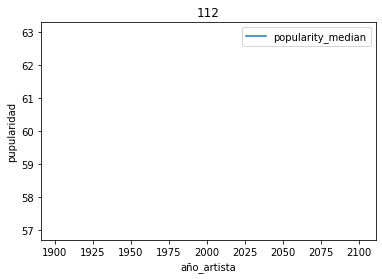

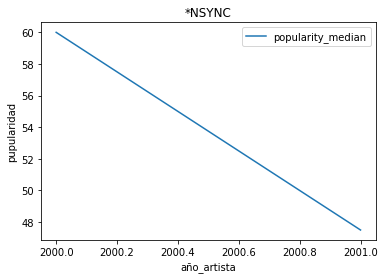

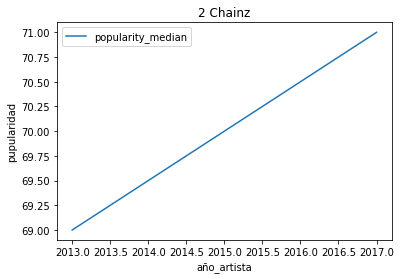

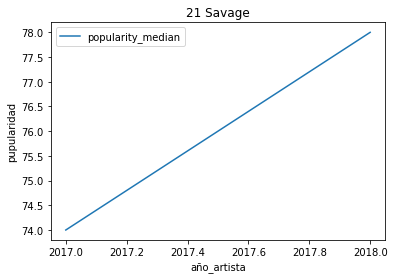

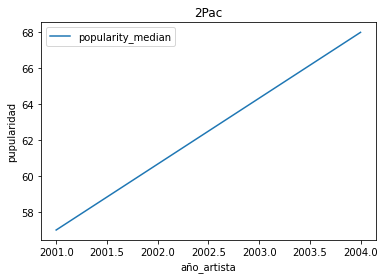

...

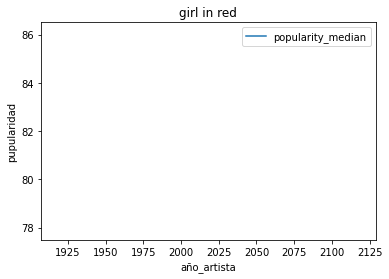

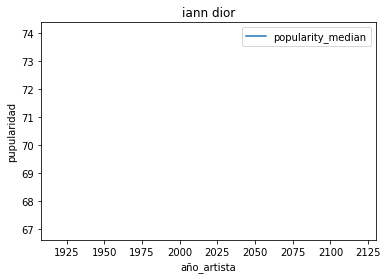

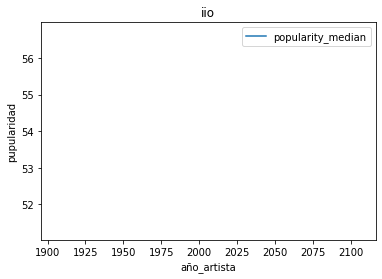

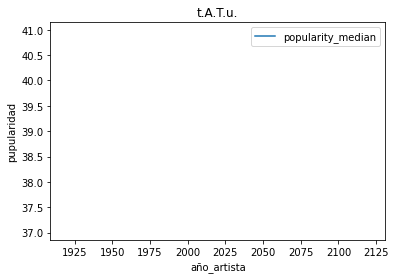

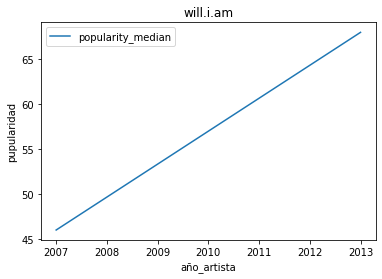

In [326]:

#x['artista_ano'] = 
x['ano_art'] = x['artist'].astype(str)+x['year'].astype(str)
for artista in x.artist.unique():
  ax = x[x['artist']==artista].plot(title = artista, x='year', y='popularity_median')
  ax.set_xlabel("año_artista")
  ax.set_ylabel("pupularidad")

### RESPUESTA:

No tengo claridad de cómo responder esta pregunta ya que puedo considerar un artista como nuevo en cualquier momento del tiempo después de 1998 (el dato más antiguo que tenemos) por ejemplo si el primer año de aparición del artista fue en el año 2000 se podría considerar como nuevo en ese momento, y así para todos los años siguientes. Por otro lado, no todos los artistas tienen datos completos sino solo un segmento del tiempo entre 1998 y 2020. Por ejemplo hay artistas que solo muestran un par de años y no se puede ver la tendencia (así el artista sea conocido hoy en día y siga activo).

Consideraré artistas nuevos (arbitrariamente pero con fechas superiores al 2012) como Nick Jonas, su primer dato es del 2014 el cual inició con una popularidad de 0 y para el 2016 subió a 70 (mediana).

Otro ejemplo es Nicky Jam con una popularidad de 50 en el 2019 y una popularidad de 75 para el 2019.

One direction también es un ejemplo de artista nuevo con una popularidad que subió exponencialmente desde su aparición. Tenían una popularidad de 40 para subirla a su pico en el 2014 con 80 y terminar con 75 para el 2015.
Algo interesante que podemos notar en las gráficas es que artistas con más antigüedad (antes del 2010) tienen el efecto contrario y su popularidad ha bajado substancialmente.
Por ejemplo:
Lorde: ha bajado de 80 puntos de popularidad a 10 puntos para el 2017.

Linking park: una popularidad de 85 en el año 2000 puntos ha bajado a menos de 75 para el 2012.


#Punto 5 (15 pts) Grafique la progresión de la popularidad promedio por género y por año. Concluya sobre la gráfica, ej: ¿existen tendencias?

In [252]:
pnt5_df = spotify_df
pnt5_df['genre'] = spotify_df['genre'].str.replace('"','')
#pnt5_df['mean_popularity'] = spotify_df['popularity'].mean()
#pnt5_df.head()
pnt5_df['year'] = pnt5_df['year'].astype(str)
pnt5_df = pnt5_df.groupby(by = ['genre','year'])['popularity'].mean().reset_index()
#type(np.add.reduce(pnt5_df[['genre','year']], axis=1))
#type(pnt5_df)
pnt5_df['ano_gen'] = pnt5_df['genre']+pnt5_df['year']
#pnt5_df= pnt5_df.drop(['genre','year'],axis=1)
pnt5_df.head()

,genre,year,popularity,ano_gen
0,Dance/Electronic,1999,56.0,Dance/Electronic1999
1,Dance/Electronic,2000,50.0,Dance/Electronic2000
2,Dance/Electronic,2001,59.4,Dance/Electronic2001
3,Dance/Electronic,2002,48.0,Dance/Electronic2002
4,Dance/Electronic,2003,57.0,Dance/Electronic2003


array(['Dance/Electronic', 'Folk/Acoustic- pop', 'Folk/Acoustic- rock',
       'Folk/Acoustic- rock- pop', 'R&B',
       'World/Traditional- Folk/Acoustic', 'World/Traditional- hip hop',
       'World/Traditional- pop', 'World/Traditional- pop- Folk/Acoustic',
       'World/Traditional- rock', 'World/Traditional- rock- pop',
       'country', 'country- latin', 'easy listening', 'hip hop',
       'hip hop- Dance/Electronic', 'hip hop- R&B', 'hip hop- country',
       'hip hop- latin- Dance/Electronic', 'hip hop- pop',
       'hip hop- pop- Dance/Electronic', 'hip hop- pop- R&B',
       'hip hop- pop- R&B- Dance/Electronic', 'hip hop- pop- R&B- latin',
       'hip hop- pop- country', 'hip hop- pop- latin',
       'hip hop- pop- rock', 'hip hop- rock- pop', 'latin', 'metal',
       'pop', 'pop- Dance/Electronic', 'pop- Folk/Acoustic', 'pop- R&B',
       'pop- R&B- Dance/Electronic', 'pop- R&B- easy listening',
       'pop- country', 'pop- easy listening- Dance/Electronic',
       'pop- ea

Text(0, 0.5, 'año')

<Figure size 936x720 with 0 Axes>

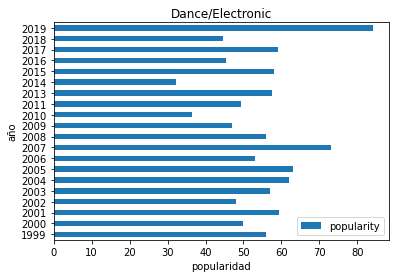

In [255]:
plt.figure(figsize =(13,10))
#pnt5_df['ano_gen'].hist(bins = 50)
#plt.yscale('log')
ax = pnt5_df[pnt5_df['genre']=='Dance/Electronic'].plot(kind = 'barh', title = 'Dance/Electronic',x='year')
ax.set_xlabel("popularidad")
ax.set_ylabel("año")
#sns.boxplot(x = 'ano_gen', y = 'popularity', data=pnt5_df)

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

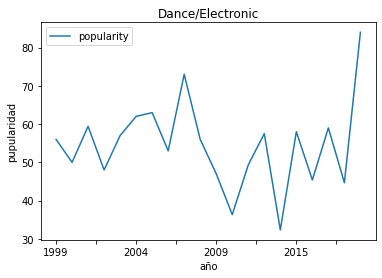

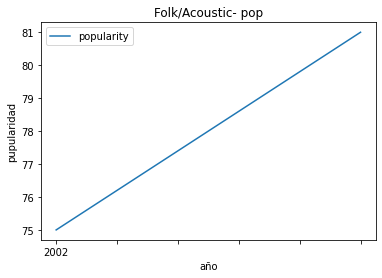

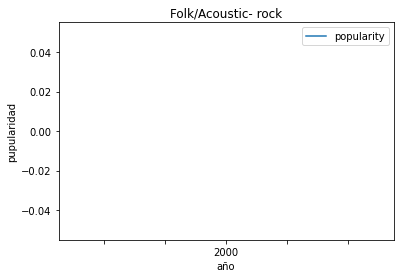

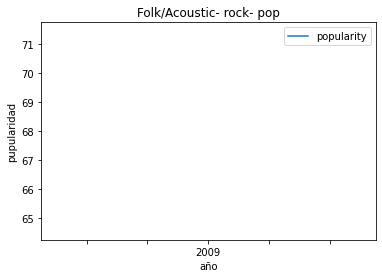

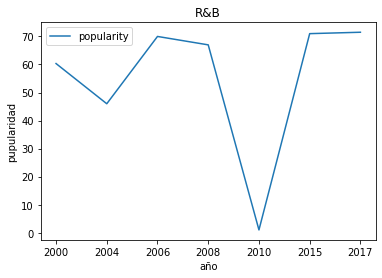

...

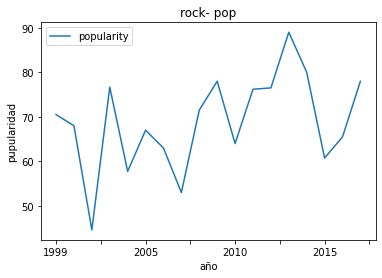

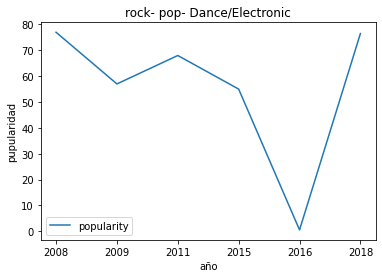

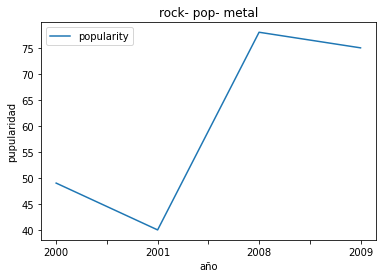

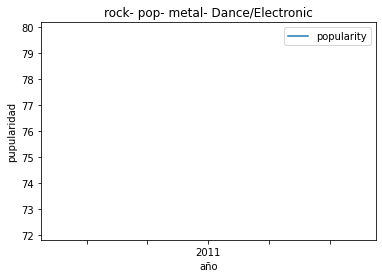

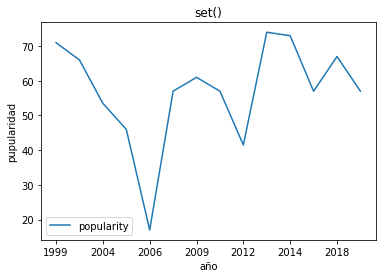

In [263]:

for genero in pnt5_df.genre.unique():
  ax = pnt5_df[pnt5_df['genre']==genero].plot(title = genero, x='year', y='popularity')
  ax.set_xlabel("año")
  ax.set_ylabel("pupularidad")

In [ ]:
for genero in pnt5_df.genre.unique():
  ax = pnt5_df[pnt5_df['genre']==genero].plot(kind = 'barh', title = genero,x='year')
  ax.set_xlabel("popularidad")
  ax.set_ylabel("año")

### RESPUESTA:
Latin ha tenido un aumento en popularidad considerable a partir del 2011.
Hip-hop’pop ha tenido una caída considerable desde el 2018.

dance/electronic, latin, r&B los consideraría tendencia ya que han tenido un gran aumento de popularidad en los últimos años, y son de los géneros con más datos, por ejemplo hip-hop country no tiene datos para graficar y poder obtener insights. 


# Punto 6 (20 pts) Compare los géneros Pop y Rock según sus características de: energy, valence y tempo.Concluya sobre su análisis.

In [267]:
pnt6_df = spotify_df
#pnt6_df['genre'] = spotify_df['genre'].str.replace('"','')
#pnt5_df['mean_popularity'] = spotify_df['popularity'].mean()
#pnt5_df.head()
pnt6_rock_df = pnt6_df[pnt6_df['genre']=='rock']
pnt6_pop_df = pnt6_df[pnt6_df['genre']=='pop']

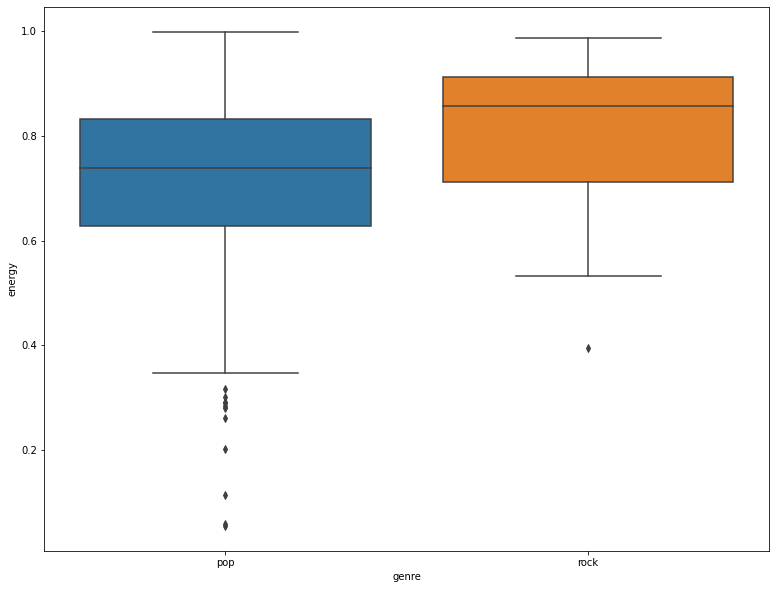

In [268]:
# Plotting wage by club
plt.figure(figsize = (13, 10))
sns.boxplot(x = 'genre', y = 'energy', data = pnt6_df.loc[pnt6_df['genre'].isin(['pop', 'rock'])])

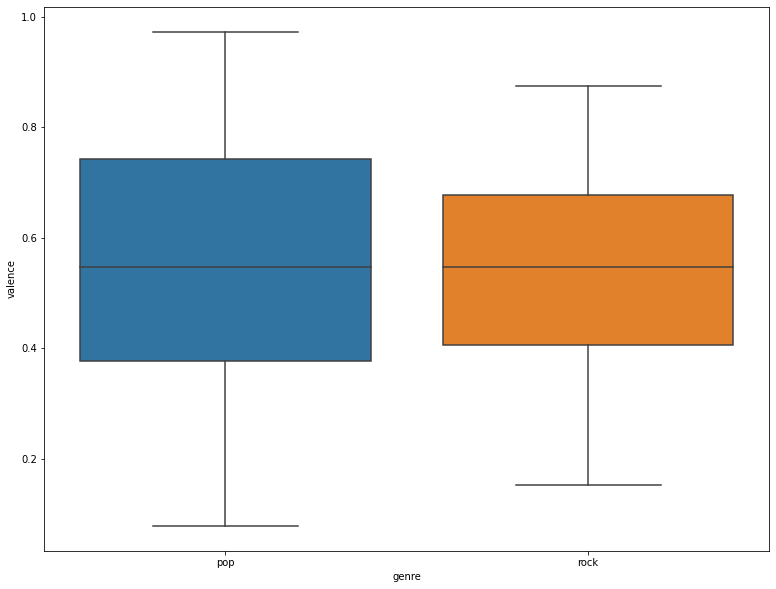

In [269]:
# Plotting wage by club
plt.figure(figsize = (13, 10))
sns.boxplot(x = 'genre', y = 'valence', data = pnt6_df.loc[pnt6_df['genre'].isin(['pop', 'rock'])])

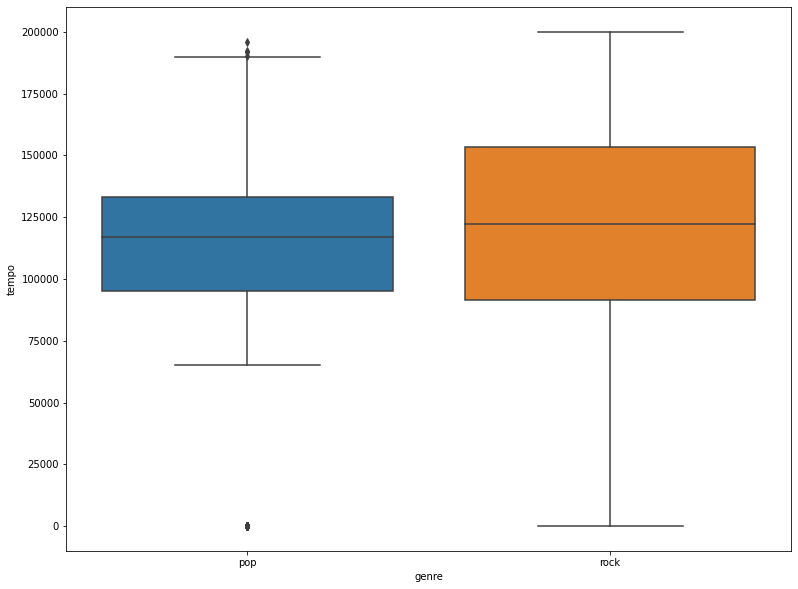

In [270]:
# Plotting wage by club
plt.figure(figsize = (13, 10))
sns.boxplot(x = 'genre', y = 'tempo', data = pnt6_df.loc[pnt6_df['genre'].isin(['pop', 'rock'])])

### RESPUESTA:
El rock tiende a ser de tempo más rápido lo que puede implicar a que tenga una “energía” mayor  respecto a las medidas de intensidad y actividad tomadas por spotify. En cambio el pop tiende a ser más tranquilo y relajante con un tempo más lento provocando una sensación de positividad para los que escuchan este género. En conclusión Rock para estar activo y pop para relajarse.

# Punto 7 (15 pts) Plantee una pregunta de negocio de su interés, ya sea por tipo de música, artistas u otra dimensión, mediante la cual se analicen al menos 3 variables del dataset y concluya.

# ¿Cuáles son los 5 artistas con la mayor popularidad (mediana), con contenido explícito en el año 2019 (suponiendo que es el año actual pero no hay datos del 2022) por género? esto sirve para realizar un marketing directo para eventos y las personas que van a asistir.

In [285]:
pnt7_df = spotify_df[(spotify_df['year']=='2019') & (spotify_df['explicit']==True)]
pnt7_df = pnt7_df[['artist','popularity','genre']]
pnt7_df.head()

,artist,popularity,genre
333,Lil' Kim,47.0,hip hop- pop- R&B
1779,Hayden James,47.0,pop- Dance/Electronic
1903,Ariana Grande,83.0,pop
1905,Gesaffelstein,84.0,Dance/Electronic
1912,Mustard,75.0,hip hop- pop


In [291]:
pnt7_df.groupby(['artist','genre']).median().dropna().sort_values(by ='popularity', ascending = False)

,,popularity
artist,genre,
Gesaffelstein,Dance/Electronic,84.0
Bad Bunny,latin,81.0
Tyler The Creator,hip hop,80.0
Lana Del Rey,pop,80.0
J. Cole,hip hop,80.0
Lil Tecca,hip hop,78.0
Polo G,hip hop,78.0
Dave,hip hop,78.0
Ariana Grande,pop,77.0


### RESPUESTA:

* Gesaffelstein 	Dance/Electronic 	84.0
* Bad Bunny 	latin 	81.0
* Tyler The Creator 	hip hop 	80.0
* Lana Del Rey 	pop 	80.0
* Drake 	hip hop- pop- R&B 	76.0